In [2]:
import pandas as pd

In [3]:
housing=pd.read_csv('./housing.csv')
housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [4]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [5]:
##There are 20,640 samples in dataset.
##total_bedrooms has 20433 non-null meaning it has 207 other features.
##The type of ocean_proximity is object, probably which is categorial type.

In [6]:
# What type ocean_proximity is?
housing['ocean_proximity'].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

In [7]:
##Check the type of observation with value_counts()

In [35]:
#Show me the summary of housing
housing.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,16512.000000,16512.000000,16512.000000,16512.000000,16354.000000,16512.000000,16512.000000,16512.000000,16512.000000
mean,-119.575834,35.639577,28.653101,2622.728319,534.973890,1419.790819,497.060380,3.875589,206990.920724
std,2.001860,2.138058,12.574726,2138.458419,412.699041,1115.686241,375.720845,1.904950,115703.014830
min,-124.350000,32.540000,1.000000,6.000000,2.000000,3.000000,2.000000,0.499900,14999.000000
25%,-121.800000,33.940000,18.000000,1443.000000,295.000000,784.000000,279.000000,2.566775,119800.000000
50%,-118.510000,34.260000,29.000000,2119.500000,433.000000,1164.000000,408.000000,3.540900,179500.000000
75%,-118.010000,37.720000,37.000000,3141.000000,644.000000,1719.250000,602.000000,4.744475,263900.000000
max,-114.310000,41.950000,52.000000,39320.000000,6210.000000,35682.000000,5358.000000,15.000100,500001.000000


In [9]:
##Basic statistical details with describe()
##Excluded null(e.x., total_bedrooms has only 20433)

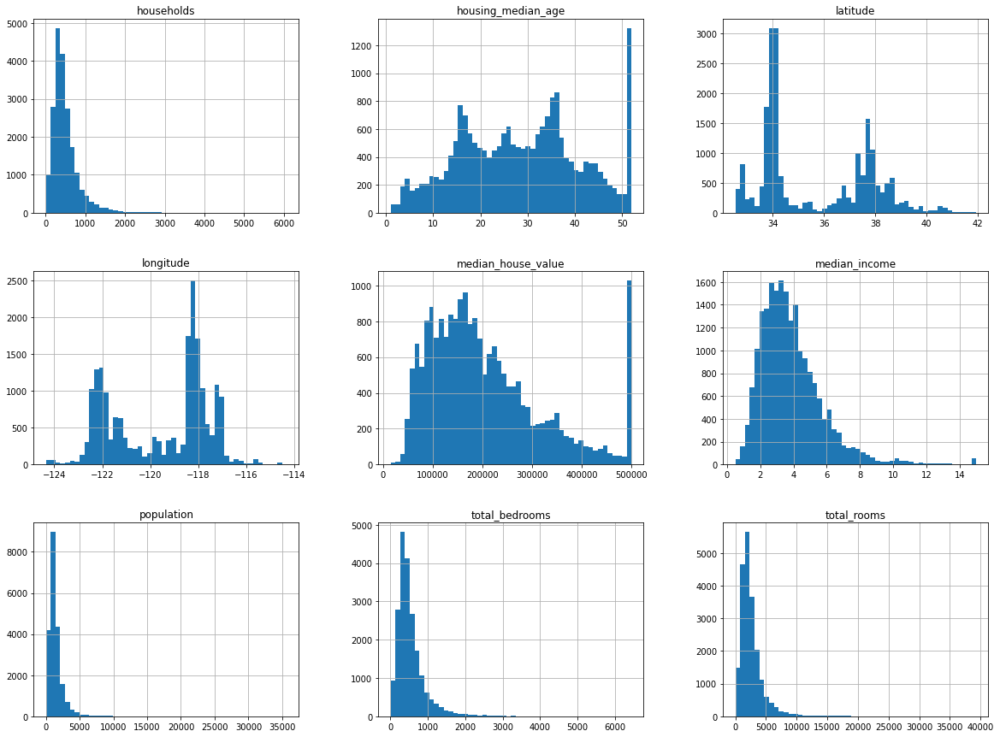

In [10]:
#Histogram
%matplotlib inline
import matplotlib.pyplot as plt
housing.hist(bins=50, figsize=(20,15))
plt.show()

In [11]:
##Restricted min and max in housing_median_age and housing_median_value.
##There are various scales. 
##Although most of median income flocked between $20,000 and $50,000, over $60,000 part of them. 
##It needs stratified sampling. Otherwise, it has probable to bias. 

In [12]:
#Test Set

import numpy as np 

def split_train_test(data, test_ratio):
    shuffled_indices = np.random.permutation(len(data))
    test_set_size = int(len(data) * test_ratio)
    test_indices = shuffled_indices[:test_set_size]
    train_indices = shuffled_indices[test_set_size:]
    return data.iloc[train_indices], data.iloc[test_indices]

In [13]:
##Above is same as below with split_train_testsplit_train_test()
train_set, test_set=split_train_test(housing,0.2)
print(len(train_set),'train +',len(test_set),'test')

16512 train + 4128 test


In [14]:
from zlib import crc32

def test_set_check(identifier, test_ratio):
    return crc32(np.int64(identifier)) & 0xffffffff < test_ratio * 2**32

def split_train_test_by_id(data, test_ratio, id_column):
    ids = data[id_column]
    in_test_set = ids.apply(lambda id_: test_set_check(id_, test_ratio))
    return data.loc[~in_test_set], data.loc[in_test_set]

In [15]:
##Keep same test set, when implement new test. 
##Exclude the sample from train set when implement new test, which has 20% of new sample.

In [16]:
#Identify the culumn
housing_with_id=housing.reset_index()
train_set,test_set=split_train_test_by_id(housing_with_id,0.2, 'index')

In [17]:
##When it used as identifier, it should be added at the end of dataset.

In [18]:
#Create ID of longitude and latitude
housing_with_id["id"]=housing['longitude']*1000+housing['latitude']
train_set,test_set=split_train_test_by_id(housing_with_id,0.2, 'id')

In [19]:
#Utilize train_test_split
from sklearn.model_selection import train_test_split
train_set,test_set=train_test_split(housing,test_size=0.2, random_state=42)

In [20]:
#Devide the median_income to 1.5 in order to restrict the category. 
housing['income_cat']=np.ceil(housing['median_income']/1.5)
##Round up with ceil()

#Labeling over 5 to 5
housing['income_cat'].where(housing['income_cat']<5,5.0, inplace=True)

In [21]:
housing['income_cat'].value_counts()

3.0    7236
2.0    6581
4.0    3639
5.0    2362
1.0     822
Name: income_cat, dtype: int64

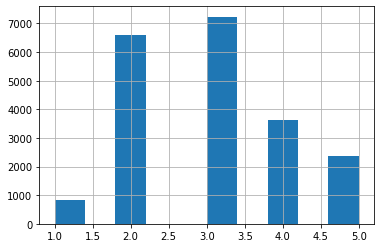

In [22]:
#Histogram
housing['income_cat'].hist()

In [23]:
#Stratified Sampling
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(housing, housing['income_cat']):
    strat_train_set = housing.loc[train_index]
    strat_test_set = housing.loc[test_index]

In [24]:
housing['income_cat'].value_counts()/len(housing)

3.0    0.350581
2.0    0.318847
4.0    0.176308
5.0    0.114438
1.0    0.039826
Name: income_cat, dtype: float64

In [25]:
#Compare Proportion
def income_cat_proportions(data):
    return data['income_cat'].value_counts() / len(data)

train_set, test_set = train_test_split(housing, test_size=0.2, random_state=42)

compare_props = pd.DataFrame({
    'Overall': income_cat_proportions(housing),
    'Stratified': income_cat_proportions(strat_test_set),
    'Random': income_cat_proportions(test_set),
}).sort_index()
compare_props["Rand. %error"] = 100 * compare_props["Random"] / compare_props["Overall"] - 100
compare_props["Strat. %error"] = 100 * compare_props["Stratified"] / compare_props["Overall"] - 100

In [26]:
compare_props

,Overall,Stratified,Random,Rand. %error,Strat. %error
1.0,0.039826,0.039729,0.040213,0.973236,-0.243309
2.0,0.318847,0.318798,0.324370,1.732260,-0.015195
3.0,0.350581,0.350533,0.358527,2.266446,-0.013820
4.0,0.176308,0.176357,0.167393,-5.056334,0.027480
5.0,0.114438,0.114583,0.109496,-4.318374,0.127011


In [27]:
##Stratified is similar as overall whereas random is quite different.

In [28]:
#Unscramble
for set_ in (strat_train_set, strat_test_set):
    set_.drop("income_cat", axis=1, inplace=True)

In [29]:
#Copy
housing=strat_train_set.copy()

[Text(0, 0.5, 'latitude'), Text(0.5, 0, 'longitude')]

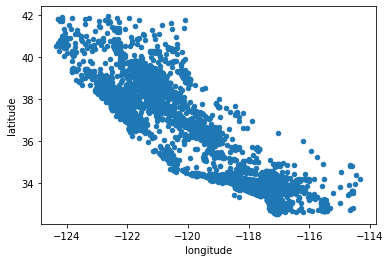

In [31]:
#Plot
ax=housing.plot(kind='scatter', x="longitude", y="latitude")
ax.set(xlabel='longitude', ylabel='latitude')

[Text(0, 0.5, 'latitude'), Text(0.5, 0, 'longitude')]

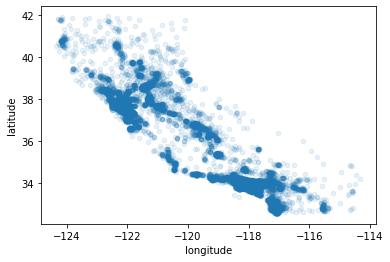

In [32]:
##Hard to recognize specific pattern. 
#Let's apply alpha=0.1 to be vivid.

ax = housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1)
ax.set(xlabel='longitude', ylabel='latitude')

In [ ]:
##Plot has highlighted congested district. 

In [37]:
#Housing price plot
ax = housing.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4, s=housing['population']/100,
##s means a radius of circle is population of district. 
label='population', figsize=(10,7),
c='median_house_value', cmap=plt.get_cmap('jet'), colorbar=True, sharex=False)
##c means housing price.
##Implemented colormap(cmap)
##Jet has range from min(blue) to red(max).
ax.set(xlabel='longitude', ylabel='latitude')
plt.legend()

SyntaxError: invalid syntax (<ipython-input-37-7e6963933fd9>, line 1)

In [38]:
**Closer to the sea, higher density.

SyntaxError: invalid syntax (<ipython-input-38-c2c5544455a3>, line 1)

In [43]:
#Standard Correlation Coefficient
corr_matrix=housing.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.687160
total_rooms           0.135097
housing_median_age    0.114110
households            0.064506
total_bedrooms        0.047689
population           -0.026920
longitude            -0.047432
latitude             -0.142724
Name: median_house_value, dtype: float64

In [ ]:
##The range of correlation is from -1 to 1. 
##Closer 1, positive correlation. e.x.,increase median_house_value when median_income increases.
##Closer -1, negative correlation. e.x.,closer to northern(latitude), decreases median_house_value. 

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x13abc2ee0>,
      dtype=object)

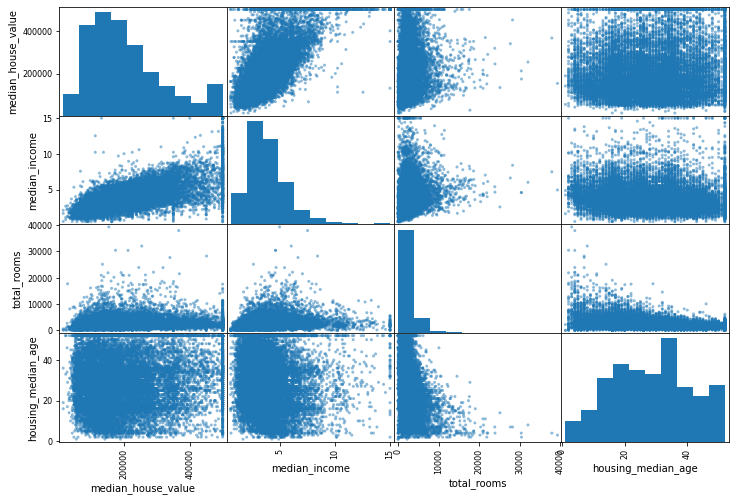

In [48]:
#Scatter Matrix
from pandas.plotting import scatter_matrix

attributes = ["median_house_value", "median_income", "total_rooms","housing_median_age"]
scatter_matrix(housing[attributes], figsize=(12, 8))

In [ ]:
##A diagonal is variable itself. 

(0.0, 16.0, 0.0, 550000.0)

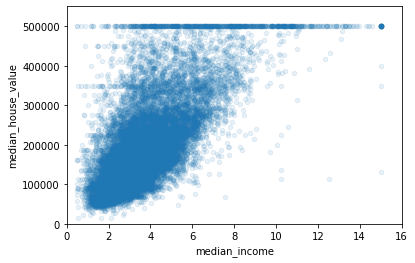

In [49]:
#Enlarge the plot about median_house_value. 
housing.plot(kind='scatter', x="median_income", y="median_house_value",alpha=0.1)
plt.axis([0, 16, 0, 550000])

In [ ]:
##According to this plot, 
##1. There is strong correlation, tends to toword up, points concentrated. 
##2. Restricted housing price is obvious. 
##3. There are some horizontal lines near $450,000, between $350,000 and 280,000.

In [50]:
#Attributes
housing["rooms_per_household"] = housing["total_rooms"]/housing["households"]
housing["bedrooms_per_room"] = housing["total_bedrooms"]/housing["total_rooms"]
housing["population_per_household"]=housing["population"]/housing["households"]

In [52]:
#Correlation Coefficient between attributes
corr_matrix=housing.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)

median_house_value          1.000000
median_income               0.687160
rooms_per_household         0.146285
total_rooms                 0.135097
housing_median_age          0.114110
households                  0.064506
total_bedrooms              0.047689
population_per_household   -0.021985
population                 -0.026920
longitude                  -0.047432
latitude                   -0.142724
bedrooms_per_room          -0.259984
Name: median_house_value, dtype: float64

In [ ]:
##bedrooms_per_room attributes has higher correlation rather than total_rooms or total_bedrooms. Meaning less bedroom tends to expensive. 
##rooms_per_household is meaningful than total_rooms. Meaning bigger size, more expensive. 

In [54]:
#Refine the data for Machine Learning Algorithm
housing=strat_train_set.drop('median_house_value',axis=1)
##Delete the label 
housing_labels=strat_train_set['median_house_value'].copy()

In [55]:
sample_incomplete_rows=housing[housing.isnull().any(axis=1)].head()
sample_incomplete_rows

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
4629,-118.30,34.07,18.0,3759.0,NaN,3296.0,1462.0,2.2708,<1H OCEAN
6068,-117.86,34.01,16.0,4632.0,NaN,3038.0,727.0,5.1762,<1H OCEAN
17923,-121.97,37.35,30.0,1955.0,NaN,999.0,386.0,4.6328,<1H OCEAN
13656,-117.30,34.05,6.0,2155.0,NaN,1039.0,391.0,1.6675,INLAND
19252,-122.79,38.48,7.0,6837.0,NaN,3468.0,1405.0,3.1662,<1H OCEAN


In [ ]:
##There are Nan in total_bedrooms.

In [56]:
sample_incomplete_rows.dropna(subset=['total_bedrooms'])
##Delete the Nan with dropna().

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity


In [57]:
sample_incomplete_rows.drop('total_bedrooms',axis=1)
##Drop the attribute with drop()

,longitude,latitude,housing_median_age,total_rooms,population,households,median_income,ocean_proximity
4629,-118.30,34.07,18.0,3759.0,3296.0,1462.0,2.2708,<1H OCEAN
6068,-117.86,34.01,16.0,4632.0,3038.0,727.0,5.1762,<1H OCEAN
17923,-121.97,37.35,30.0,1955.0,999.0,386.0,4.6328,<1H OCEAN
13656,-117.30,34.05,6.0,2155.0,1039.0,391.0,1.6675,INLAND
19252,-122.79,38.48,7.0,6837.0,3468.0,1405.0,3.1662,<1H OCEAN


In [58]:
median=housing['total_bedrooms'].median()
sample_incomplete_rows['total_bedrooms'].fillna(median, inplace=True)
sample_incomplete_rows
##Fill with median with fillna()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
4629,-118.30,34.07,18.0,3759.0,433.0,3296.0,1462.0,2.2708,<1H OCEAN
6068,-117.86,34.01,16.0,4632.0,433.0,3038.0,727.0,5.1762,<1H OCEAN
17923,-121.97,37.35,30.0,1955.0,433.0,999.0,386.0,4.6328,<1H OCEAN
13656,-117.30,34.05,6.0,2155.0,433.0,1039.0,391.0,1.6675,INLAND
19252,-122.79,38.48,7.0,6837.0,433.0,3468.0,1405.0,3.1662,<1H OCEAN


In [62]:
#Imputer
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")
##Assume null replaces to median.
##Handle null with Imputer.

In [63]:
housing_num=housing.drop('ocean_proximity',axis=1)
##Drop ocean_proximity in order to calulate numeric type only. 

In [64]:
imputer.fit(housing_num)

SimpleImputer(add_indicator=False, copy=True, fill_value=None,
              missing_values=nan, strategy='median', verbose=0)

In [65]:
imputer.statistics_

array([-118.51  ,   34.26  ,   29.    , 2119.5   ,  433.    , 1164.    ,
        408.    ,    3.5409])

In [66]:
housing_num.median().values

array([-118.51  ,   34.26  ,   29.    , 2119.5   ,  433.    , 1164.    ,
        408.    ,    3.5409])

In [ ]:
##Every result is same. 

In [67]:
#Change train set
X=imputer.transform(housing_num)

In [68]:
housing_tr=pd.DataFrame(X, columns=housing_num.columns,
index=list(housing.index.values))

In [69]:
housing_cat=housing['ocean_proximity']
housing_cat.head()

17606     <1H OCEAN
18632     <1H OCEAN
14650    NEAR OCEAN
3230         INLAND
3555      <1H OCEAN
Name: ocean_proximity, dtype: object

In [71]:
housing_cat_encoded, housing_categories=housing_cat.factorize()
##Change character type to numeric type with factorize()
housing_cat_encoded[:10]

array([0, 0, 1, 2, 0, 2, 0, 2, 0, 0])

In [72]:
housing_categories

Index(['<1H OCEAN', 'NEAR OCEAN', 'INLAND', 'NEAR BAY', 'ISLAND'], dtype='object')

In [74]:
#One-Hot Encoding
from sklearn.preprocessing import OneHotEncoder

encoder=OneHotEncoder(categories='auto')
housing_cat_1hot=encoder.fit_transform(housing_cat_encoded.reshape(-1,1))
housing_cat_1hot

<16512x5 sparse matrix of type '<class 'numpy.float64'>'
	with 16512 stored elements in Compressed Sparse Row format>

In [ ]:
##If only one feasure is 1, others are 0, use OneHotEncoder to change from categorical to vector. 

In [75]:
housing_cat_1hot.toarray()

array([[1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       ...,
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.]])

In [99]:
from sklearn.base import BaseEstimator, TransformerMixin

rooms_ix, bedrooms_ix, population_ix, household_ix = 3, 4, 5, 6
class CombinedAttributesAdder(BaseEstimator, TransformerMixin):
    def __init__(self, add_bedrooms_per_room=True):
        self.add_bedrooms_per_room=add_bedrooms_per_room
    def fit(self, X, y=None):
        return self
    def transform(self, X, y=None):
        rooms_per_household = X[:, rooms_ix] / X[:, household_ix]
        population_per_household = X[:, population_ix] / X[:, household_ix]
        if self.add_bedrooms_per_room:
            add_bedrooms_per_room=X[:, bedrooms_ix] / X[:, rooms_ix]
            return np.c_[X, rooms_per_household, population_per_household,
                         bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household]

attr_adder = CombinedAttributesAdder(add_bedrooms_per_room=False)
housing_extra_attribs=attr_adder.transform(housing.values)

In [100]:
housing_extra_attribs = pd.DataFrame(
    housing_extra_attribs, 
    columns=list(housing.columns)+["rooms_per_household", "population_per_household"])
housing_extra_attribs.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,population_per_household
0,-121.89,37.29,38,1568,351,710,339,2.7042,<1H OCEAN,4.62537,2.0944
1,-121.93,37.05,14,679,108,306,113,6.4214,<1H OCEAN,6.00885,2.70796
2,-117.2,32.77,31,1952,471,936,462,2.8621,NEAR OCEAN,4.22511,2.02597
3,-119.61,36.31,25,1847,371,1460,353,1.8839,INLAND,5.23229,4.13598
4,-118.59,34.23,17,6592,1525,4459,1463,3.0347,<1H OCEAN,4.50581,3.04785


In [101]:
from sklearn.base import BaseEstimator, TransformerMixin

class DataFrameSelector(BaseEstimator, TransformerMixin):
    ##Data transform from dataframe to numpy array with DataFrameSelector.
    def __init__(self, attribute_names):
        self.attribute_names=attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names].values